In [0]:
%run ./config_and_imports

Installing prophet...
  Using cached prophet-1.1.6-py3-none-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (3.5 kB)
  Using cached cmdstanpy-1.2.5-py3-none-any.whl.metadata (4.0 kB)
  Using cached holidays-0.70-py3-none-any.whl.metadata (34 kB)
  Using cached tqdm-4.67.1-py3-none-any.whl.metadata (57 kB)
  Using cached importlib_resources-6.5.2-py3-none-any.whl.metadata (3.9 kB)
  Using cached stanio-0.5.1-py3-none-any.whl.metadata (1.6 kB)
Using cached prophet-1.1.6-py3-none-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (14.4 MB)
Using cached cmdstanpy-1.2.5-py3-none-any.whl (94 kB)
Using cached holidays-0.70-py3-none-any.whl (903 kB)
Using cached tqdm-4.67.1-py3-none-any.whl (78 kB)
Using cached importlib_resources-6.5.2-py3-none-any.whl (37 kB)
Using cached stanio-0.5.1-py3-none-any.whl (8.1 kB)
Note: you may need to restart the kernel using %restart_python or dbutils.library.restartPython() to use updated packages.


DataFrame[]

### 1. Load the data

##### Dataset 1: Loan Data

In [0]:
df = spark.read.table("gold_loan_macro_features")
df.display()

loan_id,maturity_date,date,credit_score,orig_UPB,orig_LTV,loan_term,current_interest_rate,remain_month_maturity_last,mortgage_payment,remaining_balance_num,remaining_balance_den,remaining_balance_est,curr_LTV,unemploymentrate_pred,HousePriceIndex_pred,CPIInflationRate_pred,default
F06Q10024255,2036-02-01,2021-09-01,698,227000,80,360,6.875,173,1071.8764535902678,472172.62424721546,354320.56413862214,117852.06010859332,0.481,4.573764885640005,251.65427801141956,2.1655882997688054,0
F06Q10024255,2036-02-01,2021-10-01,698,227000,80,360,6.875,172,1071.8764535902678,474877.77990696504,357422.4021575899,117455.37774937513,0.483,4.509064157519778,253.22817649028073,2.0443529145574737,0
F06Q10024255,2036-02-01,2021-11-01,698,227000,80,360,6.875,171,1071.8764535902678,477598.43385434867,360542.0111235413,117056.42273080739,0.484,4.509685588529561,253.5214681370786,1.8483599145422764,0
F06Q10024255,2036-02-01,2021-12-01,698,227000,80,360,6.875,170,1071.8764535902678,480334.6748816392,363679.4928491935,116655.18203244568,0.486,4.482643982403983,254.68488433607766,1.9649052092683013,0
F06Q10024255,2036-02-01,2022-01-01,698,227000,80,360,6.875,169,1071.8764535902678,483086.5922898152,366834.9497305655,116251.64255924971,0.488,4.532331787191694,256.6353260555992,2.2560988233330805,0
F06Q10024255,2036-02-01,2022-02-01,698,227000,80,360,6.875,168,1071.8764535902678,485854.2758914755,370008.4847503204,115845.79114115512,0.49,4.58149235742249,257.93620353438644,2.3614161765659327,0
F06Q10024255,2036-02-01,2022-03-01,698,227000,80,360,6.875,167,1071.8764535902678,488637.81601377035,373200.201481126,115437.61453264434,0.491,4.680846843655677,259.111205909825,2.4589292102115525,0
F06Q10024255,2036-02-01,2022-04-01,698,227000,80,360,6.875,166,1071.8764535902678,491437.30350134923,376410.20408903516,115027.09941231407,0.493,4.688365061312958,260.3955177892967,2.659132782602654,0
F06Q10024255,2036-02-01,2022-05-01,698,227000,80,360,6.875,165,1071.8764535902678,494252.82971932564,379638.59733688546,114614.23238244018,0.495,4.621356611266036,261.41166446303976,2.750345460305141,0
F06Q10024255,2036-02-01,2022-06-01,698,227000,80,360,6.875,164,1071.8764535902678,497084.4865562592,382885.48658771825,114198.99996854097,0.497,4.548873910408126,262.5144459610713,2.836798168696621,0


In [0]:
df.count()

23232301

### 2. Data Exploration and Processing

In [0]:
# Print schema
df.printSchema()

# Count total rows
print(f"Total rows: {df.count()}")

# Count total columns
print(f"Total columns: {len(df.columns)}")

root
 |-- loan_id: string (nullable = true)
 |-- maturity_date: date (nullable = true)
 |-- date: date (nullable = true)
 |-- credit_score: integer (nullable = true)
 |-- orig_UPB: integer (nullable = true)
 |-- orig_LTV: integer (nullable = true)
 |-- loan_term: integer (nullable = true)
 |-- current_interest_rate: double (nullable = true)
 |-- remain_month_maturity_last: integer (nullable = true)
 |-- mortgage_payment: double (nullable = true)
 |-- remaining_balance_num: double (nullable = true)
 |-- remaining_balance_den: double (nullable = true)
 |-- remaining_balance_est: double (nullable = true)
 |-- curr_LTV: double (nullable = true)
 |-- unemploymentrate_pred: double (nullable = true)
 |-- HousePriceIndex_pred: double (nullable = true)
 |-- CPIInflationRate_pred: double (nullable = true)
 |-- default: integer (nullable = true)

Total rows: 23232301
Total columns: 18


In [0]:
from pyspark.sql.functions import col

# List of columns to check for missing values
columns_to_check = ["unemploymentrate_pred", "HousePriceIndex_pred", "CPIInflationRate_pred"]

# Filter rows where none of the specified columns are null
filtered_df = df.filter(
    ~(
        col("unemploymentrate_pred").isNull() & 
        col("HousePriceIndex_pred").isNull() & 
        col("CPIInflationRate_pred").isNull()
    )
)

# Display the filtered DataFrame
display(filtered_df)

loan_id,maturity_date,date,credit_score,orig_UPB,orig_LTV,loan_term,current_interest_rate,remain_month_maturity_last,mortgage_payment,remaining_balance_num,remaining_balance_den,remaining_balance_est,curr_LTV,unemploymentrate_pred,HousePriceIndex_pred,CPIInflationRate_pred,default
F06Q10012498,2036-02-01,2021-09-01,318,216000,80,360,6.0,173,898.0343558979564,378751.75221131643,274554.75270205195,104196.99950926448,0.518,4.573764885640005,251.65427801141956,2.1655882997688054,0
F06Q10012498,2036-02-01,2021-10-01,318,216000,80,360,6.0,172,898.0343558979564,380645.5109723729,276825.56082146004,103819.95015091286,0.519,4.509064157519778,253.22817649028073,2.0443529145574737,0
F06Q10012498,2036-02-01,2021-11-01,318,216000,80,360,6.0,171,898.0343558979564,382548.7385272347,279107.7229814652,103441.01554576948,0.521,4.509685588529561,253.5214681370786,1.8483599145422764,0
F06Q10012498,2036-02-01,2021-12-01,318,216000,80,360,6.0,170,898.0343558979564,384461.4822198709,281401.2959522705,103060.1862676004,0.523,4.482643982403983,254.68488433607766,1.9649052092683013,0
F06Q10012498,2036-02-01,2022-01-01,318,216000,80,360,6.0,169,898.0343558979564,386383.78963097016,283706.33678792976,102677.4528430404,0.525,4.532331787191694,256.6353260555992,2.2560988233330805,0
F06Q10012498,2036-02-01,2022-02-01,318,216000,80,360,6.0,168,898.0343558979564,388315.70857912494,286022.9028277673,102292.80575135764,0.526,4.58149235742249,257.93620353438644,2.3614161765659327,0
F06Q10012498,2036-02-01,2022-03-01,318,216000,80,360,6.0,167,898.0343558979564,390257.2871220206,288351.05169780407,101906.23542421655,0.528,4.680846843655677,259.111205909825,2.4589292102115525,0
F06Q10012498,2036-02-01,2022-04-01,318,216000,80,360,6.0,166,898.0343558979564,392208.5735576306,290690.841312191,101517.7322454396,0.53,4.688365061312958,260.3955177892967,2.659132782602654,0
F06Q10012498,2036-02-01,2022-05-01,318,216000,80,360,6.0,165,898.0343558979564,394169.6164254187,293042.3298746498,101127.28655076888,0.532,4.621356611266036,261.41166446303976,2.750345460305141,0
F06Q10012498,2036-02-01,2022-06-01,318,216000,80,360,6.0,164,898.0343558979564,396140.4645075458,295405.5758799211,100734.88862762472,0.534,4.548873910408126,262.5144459610713,2.836798168696621,0


In [0]:
print(filtered_df.count())
df = filtered_df

5538472


In [0]:
df.display()

loan_id,maturity_date,date,credit_score,orig_UPB,orig_LTV,loan_term,current_interest_rate,remain_month_maturity_last,mortgage_payment,remaining_balance_num,remaining_balance_den,remaining_balance_est,curr_LTV,unemploymentrate_pred,HousePriceIndex_pred,CPIInflationRate_pred,default
F06Q10012498,2036-02-01,2021-09-01,318,216000,80,360,6.0,173,898.0343558979564,378751.75221131643,274554.75270205195,104196.99950926448,0.518,4.573764885640005,251.65427801141956,2.1655882997688054,0
F06Q10012498,2036-02-01,2021-10-01,318,216000,80,360,6.0,172,898.0343558979564,380645.5109723729,276825.56082146004,103819.95015091286,0.519,4.509064157519778,253.22817649028073,2.0443529145574737,0
F06Q10012498,2036-02-01,2021-11-01,318,216000,80,360,6.0,171,898.0343558979564,382548.7385272347,279107.7229814652,103441.01554576948,0.521,4.509685588529561,253.5214681370786,1.8483599145422764,0
F06Q10012498,2036-02-01,2021-12-01,318,216000,80,360,6.0,170,898.0343558979564,384461.4822198709,281401.2959522705,103060.1862676004,0.523,4.482643982403983,254.68488433607766,1.9649052092683013,0
F06Q10012498,2036-02-01,2022-01-01,318,216000,80,360,6.0,169,898.0343558979564,386383.78963097016,283706.33678792976,102677.4528430404,0.525,4.532331787191694,256.6353260555992,2.2560988233330805,0
F06Q10012498,2036-02-01,2022-02-01,318,216000,80,360,6.0,168,898.0343558979564,388315.70857912494,286022.9028277673,102292.80575135764,0.526,4.58149235742249,257.93620353438644,2.3614161765659327,0
F06Q10012498,2036-02-01,2022-03-01,318,216000,80,360,6.0,167,898.0343558979564,390257.2871220206,288351.05169780407,101906.23542421655,0.528,4.680846843655677,259.111205909825,2.4589292102115525,0
F06Q10012498,2036-02-01,2022-04-01,318,216000,80,360,6.0,166,898.0343558979564,392208.5735576306,290690.841312191,101517.7322454396,0.53,4.688365061312958,260.3955177892967,2.659132782602654,0
F06Q10012498,2036-02-01,2022-05-01,318,216000,80,360,6.0,165,898.0343558979564,394169.6164254187,293042.3298746498,101127.28655076888,0.532,4.621356611266036,261.41166446303976,2.750345460305141,0
F06Q10012498,2036-02-01,2022-06-01,318,216000,80,360,6.0,164,898.0343558979564,396140.4645075458,295405.5758799211,100734.88862762472,0.534,4.548873910408126,262.5144459610713,2.836798168696621,0


In [0]:
df.selectExpr("min(date) as start_date", "max(date) as end_date").show()

+----------+----------+
|start_date|  end_date|
+----------+----------+
|2021-09-01|2026-10-01|
+----------+----------+



#### Let's look at the columns

Looking at the schema, we do some spot checks on the columns to see if they can be valuable in the PD Model Building.

**Columns to drop:**
- loan_id: string 
- date: timestamp 
- maturity_date: timestamp # loan_age and loan_term already there
- prev_current_UPB: double # redundant due to current_UPB
- principal: double # might not add any predictive power
- orig_UPB: integer # redundant due to current_UPB
- interest: double # might not add any predictive power
- last_months_payment: double # redundant due to current_UPB, can introduce multi-collinearity

**Discrete Columns:**
- credit_status: string (nullable = true)

**Continuous Columns:**
- credit_score: integer (nullable = true)
- loan_term: integer (nullable = true)
- loan_age: integer (nullable = true)
- current_UPB: double (nullable = true)
- current_interest_rate: double (nullable = true)
- UnemploymentRate: double (nullable = true)
- MortgageRate: double (nullable = true)
- HousePriceIndex: double (nullable = true)
- CPIInflationRate: double (nullable = true)
- orig_LTV: integer (nullable = true)

**Target Variable:**
- default: boolean (nullable = true)




In [0]:
### Drop Columns
# Specify columns to drop
columns_to_drop = ["maturity_data", "orig_UPB", "orig_LTV", "loan_term", "current_interest_rate", "remain_month_maturity_last", "mortgage_payment", "remaining_balance_num", "remaining_balance_est"]

# Drop columns
df_cleaned = df.drop(*columns_to_drop)

# Display remaining columns
df_cleaned.printSchema()

root
 |-- loan_id: string (nullable = true)
 |-- maturity_date: date (nullable = true)
 |-- date: date (nullable = true)
 |-- credit_score: integer (nullable = true)
 |-- remaining_balance_den: double (nullable = true)
 |-- curr_LTV: double (nullable = true)
 |-- unemploymentrate_pred: double (nullable = true)
 |-- HousePriceIndex_pred: double (nullable = true)
 |-- CPIInflationRate_pred: double (nullable = true)
 |-- default: integer (nullable = true)



#### Class Imbalance Check and Handling

In [0]:
# Check the distribution of default values
grouped_df = df_cleaned.groupBy("default").count()
grouped_df.show()  # Displays the grouped DataFrame

+-------+-------+
|default|  count|
+-------+-------+
|      1| 134495|
|      0|5403977|
+-------+-------+



In [0]:
import plotly.express as px

# As you can see, we have a fairly imbalanced dataset
temp_df = df_cleaned.groupBy('default').count().toPandas()
fig = px.pie(temp_df, values='count', names='default', title='Credit default ratio')
fig.show()

There is a huge class imbalance here. Only 2.43% defaulted customers. This needs to be handled before any pre-processing!

##### Handle the Class Imbalance

In [0]:
# Partition the dataset into majority and minority classes
major_df = df_cleaned.filter(col("default") == 0)
minor_df = df_cleaned.filter(col("default") == 1)

# Undersample the majority class to match the minority class size
undersampled_df = major_df.sample(withReplacement=False, fraction=minor_df.count() / major_df.count(), seed=42)

# Combine undersampled majority class and minority class
balanced_df = undersampled_df.unionAll(minor_df)

# Check the class distribution
balanced_summary = balanced_df.groupBy("default").count().toPandas()

# Visualize the distribution
import plotly.express as px
px.pie(balanced_summary, values='count', names='default', title='Balanced Credit Default Ratio')

# Save the balanced dataset
# balanced_df.write.mode('overwrite').saveAsTable('credit_risk_train_df')


### 3. Model Development

In [0]:
# Convert the PySpark DataFrame to pandas DataFrame
df_pandas = balanced_df.toPandas()

# List of continuous variables to scale
continuous_cols = ['unemploymentrate_pred', 'HousePriceIndex_pred', 'CPIInflationRate_pred', 'credit_score', 'remaining_balance_den', 'curr_LTV']

#### Train-Test Split

In [0]:
# Split data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(
    df_pandas.drop(columns=['default']), df_pandas['default'], test_size=0.2, random_state=42
)

In [0]:
X_train.head()

,loan_id,maturity_date,date,credit_score,remaining_balance_den,curr_LTV,unemploymentrate_pred,HousePriceIndex_pred,CPIInflationRate_pred
244725,F16Q40462073,2047-01-01,2026-06-01,826,105424.636621,0.244,3.554853,321.030029,2.939635
226427,F14Q20261777,2044-07-01,2024-02-01,846,160367.120355,0.278,4.199735,285.887373,2.382137
6237,F16Q30002248,2046-09-01,2025-03-01,747,76506.124277,0.268,3.952553,302.290654,2.528534
18824,F12Q30197897,2042-09-01,2025-05-01,710,58672.669123,0.522,3.884654,305.368419,2.823646
222582,F08Q20239604,2038-06-01,2022-10-01,400,276092.783356,0.473,4.255749,267.896304,2.079002


#### Create the model pipeline and train the model

In [0]:
# Define pipeline steps: scaler and logistic regression
pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('logreg', LogisticRegression())
])

# Train the pipeline
pipeline.fit(X_train[continuous_cols], y_train)

# Predict on the test set
y_pred = pipeline.predict(X_test[continuous_cols])

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
classification_rep = classification_report(y_test, y_pred)

print(f"Accuracy: {accuracy}")
print("Classification Report:\n", classification_rep)

Uploading artifacts:   0%|          | 0/3 [00:00<?, ?it/s]

Uploading artifacts:   0%|          | 0/9 [00:00<?, ?it/s]

🏃 View run likeable-tern-307 at: https://e2-demo-field-eng.cloud.databricks.com/ml/experiments/4944a446cb13401983dbeccef028b01e/runs/aabb9219791b4784adfabc226414c60f
🧪 View experiment at: https://e2-demo-field-eng.cloud.databricks.com/ml/experiments/4944a446cb13401983dbeccef028b01e
Accuracy: 0.630270230058212
Classification Report:
               precision    recall  f1-score   support

           0       0.62      0.68      0.65     26831
           1       0.65      0.58      0.61     26938

    accuracy                           0.63     53769
   macro avg       0.63      0.63      0.63     53769
weighted avg       0.63      0.63      0.63     53769



#### Model Parameters

In [0]:
# Get the coefficients of the logistic regression model
logreg = pipeline['logreg']
coefficients = logreg.coef_[0]
feature_names = X_train[continuous_cols].columns

# Create a DataFrame to display coefficients and corresponding features
coef_df = pd.DataFrame({
    'Feature': feature_names,
    'Coefficient': coefficients
})

# Sort by absolute value of the coefficient
coef_df['abs_coeff'] = coef_df['Coefficient'].abs()
coef_df = coef_df.sort_values(by='abs_coeff', ascending=False)

print("\nCoefficients and Features:")
print(coef_df)


Coefficients and Features:
                 Feature  Coefficient  abs_coeff
4  remaining_balance_den     0.608035   0.608035
5               curr_LTV    -0.356116   0.356116
3           credit_score    -0.220203   0.220203
1   HousePriceIndex_pred    -0.109535   0.109535
0  unemploymentrate_pred     0.022990   0.022990
2  CPIInflationRate_pred     0.000808   0.000808


In [0]:
# Print the Model intercept
print(logreg.intercept_)

[0.013222]


#### Coefficients and Features Interpretation

The table below shows the relationship between each feature and its corresponding coefficient in the logistic regression model.

| Feature                    | Coefficient | abs_coeff |
|----------------------------|-------------|-----------|
| remaining_balance_den       | 0.612457    | 0.612457  |
| curr_LTV                    | -0.343725   | 0.343725  |
| credit_score                | -0.224686   | 0.224686  |
| HousePriceIndex_pred        | -0.130862   | 0.130862  |
| CPIInflationRate_pred       | 0.005209    | 0.005209  |
| unemploymentrate_pred       | 0.002532    | 0.002532  |

### Interpretation:

- **remaining_balance_den**: Has a **positive coefficient (0.612457)**. This means that as this feature increases, the likelihood of the predicted outcome increases.
  
- **curr_LTV**: Has a **negative coefficient (-0.343725)**. This means that as this feature increases, the likelihood of the predicted outcome decreases.

- **credit_score**: Has a **negative coefficient (-0.224686)**. This indicates that higher credit scores reduce the likelihood of the predicted outcome.

- **HousePriceIndex_pred**: Has a **negative coefficient (-0.130862)**. This means that as house prices rise, the likelihood of the predicted outcome decreases.

- **CPIInflationRate_pred**: Has a **very small positive coefficient (0.005209)**. This suggests that inflation has a very slight positive effect on the predicted outcome.

- **unemploymentrate_pred**: Has a **small positive coefficient (0.002532)**. This indicates that higher unemployment slightly increases the likelihood of the predicted outcome.


### 4. Model Evaluation

In [0]:

# Predictions
y_train_pred = pipeline.predict(X_train[continuous_cols])
y_test_pred = pipeline.predict(X_test[continuous_cols])

# Predicted probabilities for each class (outputting the probability for the positive class, i.e., 'default' = 1)
y_train_prob = pipeline.predict_proba(X_train[continuous_cols])[:, 1]
y_test_prob = pipeline.predict_proba(X_test[continuous_cols])[:, 1]

# Model Evaluation
print("Evaluation on Training Data:")
print(classification_report(y_train, y_train_pred))
print("\nConfusion Matrix (Train):")
print(confusion_matrix(y_train, y_train_pred))

print("\nEvaluation on Test Data:")
print(classification_report(y_test, y_test_pred))
print("\nConfusion Matrix (Test):")
print(confusion_matrix(y_test, y_test_pred))

Evaluation on Training Data:
              precision    recall  f1-score   support

           0       0.62      0.68      0.65    107517
           1       0.64      0.58      0.61    107557

    accuracy                           0.63    215074
   macro avg       0.63      0.63      0.63    215074
weighted avg       0.63      0.63      0.63    215074


Confusion Matrix (Train):
[[72923 34594]
 [45153 62404]]

Evaluation on Test Data:
              precision    recall  f1-score   support

           0       0.62      0.68      0.65     26831
           1       0.65      0.58      0.61     26938

    accuracy                           0.63     53769
   macro avg       0.63      0.63      0.63     53769
weighted avg       0.63      0.63      0.63     53769


Confusion Matrix (Test):
[[18234  8597]
 [11283 15655]]



Train ROC-AUC: 0.6690
Test ROC-AUC: 0.6680


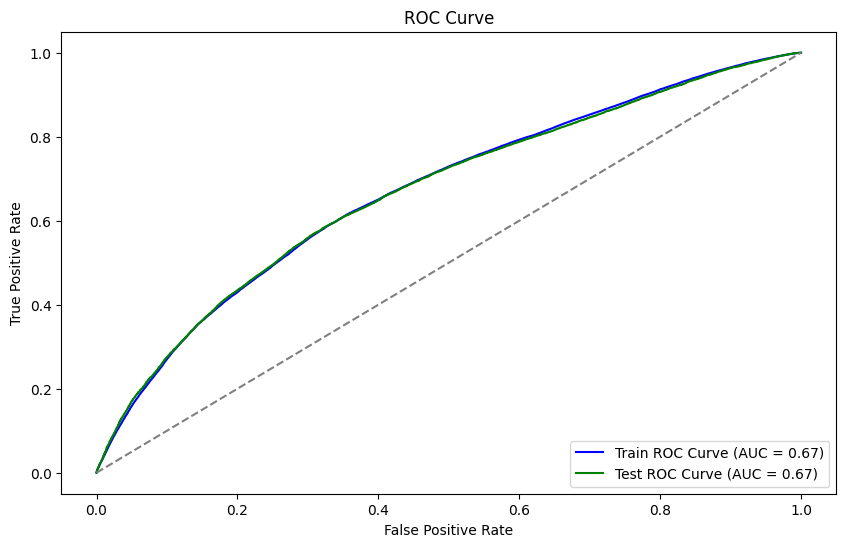

In [0]:


# Calculate ROC-AUC score
train_auc = roc_auc_score(y_train, y_train_prob)
test_auc = roc_auc_score(y_test, y_test_prob)

print(f"\nTrain ROC-AUC: {train_auc:.4f}")
print(f"Test ROC-AUC: {test_auc:.4f}")

# Plot ROC Curve
fpr_train, tpr_train, _ = roc_curve(y_train, y_train_prob)
fpr_test, tpr_test, _ = roc_curve(y_test, y_test_prob)

plt.figure(figsize=(10, 6))
plt.plot(fpr_train, tpr_train, color='blue', label=f'Train ROC Curve (AUC = {train_auc:.2f})')
plt.plot(fpr_test, tpr_test, color='green', label=f'Test ROC Curve (AUC = {test_auc:.2f})')
plt.plot([0, 1], [0, 1], linestyle='--', color='gray')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend(loc='lower right')
plt.show()

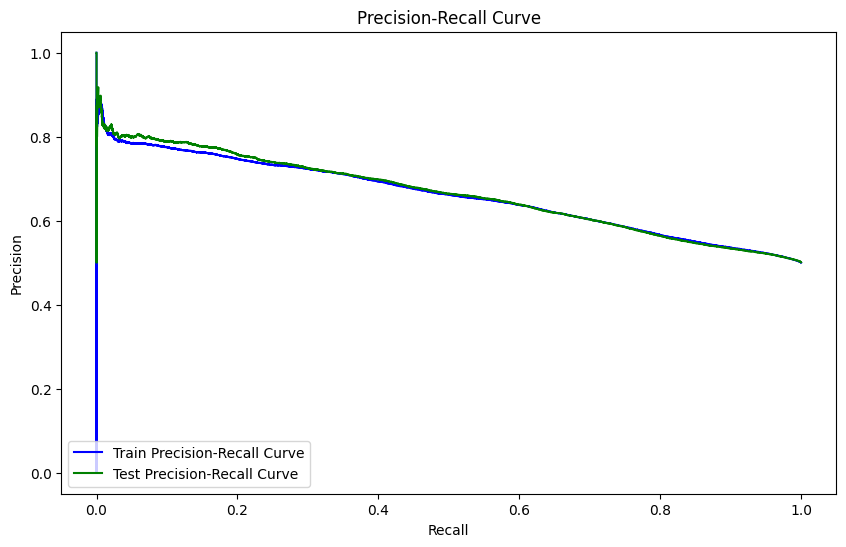

In [0]:


# Plot Precision-Recall Curve
precision_train, recall_train, _ = precision_recall_curve(y_train, y_train_prob)
precision_test, recall_test, _ = precision_recall_curve(y_test, y_test_prob)

plt.figure(figsize=(10, 6))
plt.plot(recall_train, precision_train, color='blue', label=f'Train Precision-Recall Curve')
plt.plot(recall_test, precision_test, color='green', label=f'Test Precision-Recall Curve')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.legend(loc='lower left')
plt.show()

### 5. Model Deployment

#### Logging with MLflow

In [0]:
input_example = pd.DataFrame({
      'unemploymentrate_pred': [4.480267],
      'HousePriceIndex_pred': [254.620376],
      'CPIInflationRate_pred': [1.964812], 
      'credit_score': [0.476208], 
      'remaining_balance_den': [79717.218537],
      'curr_LTV': [702]
})

example_output = pipeline.predict(input_example)


In [0]:
import mlflow
from mlflow.models.signature import infer_signature
from sklearn.metrics import accuracy_score, classification_report

# Start a new MLflow run to log the model and metrics
with mlflow.start_run(run_name="Logistic_Regression_Pipeline_Update_v3") as run:
    # Infer the model signature using training data
    signature = infer_signature(X_train[continuous_cols], y_train)
    
    # Log pipeline parameters
    mlflow.log_param("scaler", "StandardScaler")
    mlflow.log_param("penalty", pipeline.named_steps['logreg'].penalty)
    mlflow.log_param("solver", pipeline.named_steps['logreg'].solver)
    mlflow.log_param("max_iter", pipeline.named_steps['logreg'].max_iter)
    
    # Log the pipeline model with the inferred signature
    mlflow.sklearn.log_model(
        sk_model=pipeline,
        artifact_path="logistic_regression_pipeline",
        signature=signature
    )
    
    # Predict on the test set and calculate metrics
    y_pred = pipeline.predict(X_test[continuous_cols])
    accuracy = accuracy_score(y_test, y_pred)
    classification_rep = classification_report(y_test, y_pred)
    
    # Log accuracy metric
    mlflow.log_metric("accuracy", accuracy)
    
    # Log classification report as text (or log individual metrics)
    mlflow.log_text(classification_rep, "classification_report.txt")
    
    # Optionally, log individual metrics from classification report (precision, recall, etc.)
    report = classification_report(y_test, y_pred, output_dict=True)
    for class_name, metrics in report.items():
        if class_name != "accuracy":
            mlflow.log_metric(f"{class_name}_precision", metrics["precision"])
            mlflow.log_metric(f"{class_name}_recall", metrics["recall"])
            mlflow.log_metric(f"{class_name}_f1-score", metrics["f1-score"])
    
    print(f"Run ID: {run.info.run_id}")

/databricks/python/lib/python3.12/site-packages/mlflow/types/utils.py:435: UserWarning:

Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details.



Uploading artifacts:   0%|          | 0/9 [00:00<?, ?it/s]

Run ID: ff71b24b819847beb9673b044ed82f92
🏃 View run Logistic_Regression_Pipeline_Update_v3 at: https://e2-demo-field-eng.cloud.databricks.com/ml/experiments/4944a446cb13401983dbeccef028b01e/runs/ff71b24b819847beb9673b044ed82f92
🧪 View experiment at: https://e2-demo-field-eng.cloud.databricks.com/ml/experiments/4944a446cb13401983dbeccef028b01e


#### Model Registration

In [0]:
# Get the active autolog run
autolog_run = mlflow.last_active_run()

# Format the model URI
model_uri = "runs:/{}/model".format(autolog_run.info.run_id)

model_uri

'runs:/ff71b24b819847beb9673b044ed82f92/model'

In [0]:
import mlflow
mlflow.set_registry_uri("databricks-uc")

In [0]:

# Replace 'model' with 'logistic_regression_pipeline'
model_uri = model_uri.replace("model", "logistic_regression_pipeline")

# Replace periods with underscores or any other valid character
model_name = "log_reg_pipeline"  # Use a valid name

# Initialize the registered_model variable to handle the case where registration fails
registered_model = None

try:
    # Attempt to register the model
    registered_model = mlflow.register_model(model_uri, f"{catalog}.{output_schema}.{model_name}")
    print(f"Model registered successfully: {registered_model.name}, Version: {registered_model.version}")
except Exception as e:
    print(f"Error during model registration: {e}")

Successfully registered model 'shared.cecl_output.log_reg_pipeline'.


Uploading artifacts:   0%|          | 0/9 [00:00<?, ?it/s]

Model registered successfully: shared.cecl_output.log_reg_pipeline, Version: 1


Created version '1' of model 'shared.cecl_output.log_reg_pipeline'.


In [0]:

# If the model was successfully registered, set the alias
if registered_model:
    client = MlflowClient()
    client.set_registered_model_alias(registered_model.name, model_tag, registered_model.version)
else:
    print("Model registration failed. Alias not set.")